In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.spatial.distance import cdist
np.random.seed(101)

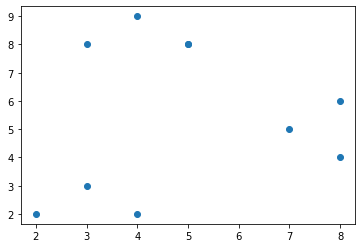

In [2]:
x = np.array([(5,8,7,8,3,4,2,3,4,5), (8,6,5,4,3,2,2,8,9,8)]).transpose()
plt.scatter(x[:, 0], x[:, 1])

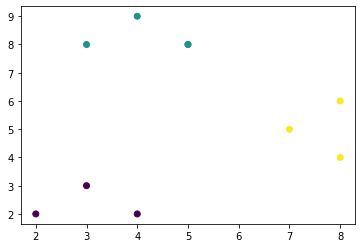

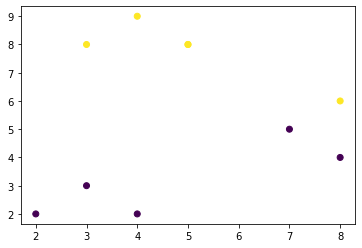

In [20]:
def k_means(x, k=3):
    clusts = np.random.choice(range(k), size=(x.shape[0]))
    done = False
    while not done:
        cents = []
        for c in range(k):
            x_c = x[np.where(clusts == c)]
            cents.append(np.mean(x_c, axis=0))
        dists = cdist(x, cents)
        new_clusts = np.argmin(dists, axis=1)
        if (clusts == new_clusts).all():
            done = True
        clusts = new_clusts
    return clusts

plt.scatter(x[:, 0], x[:, 1], c=k_means(x))
plt.show()
plt.scatter(x[:, 0], x[:, 1], c=k_means(x, k=2))
plt.show()

$k=3$ fits this data best. This makes sense since there are three human-identifiable clusters, and the $k=2$ case splits one of them in half.

In [3]:
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.preprocessing import StandardScaler
wiki = pd.read_csv('./data/wiki.csv')
wiki = pd.DataFrame(StandardScaler().fit_transform(wiki), columns=wiki.columns)

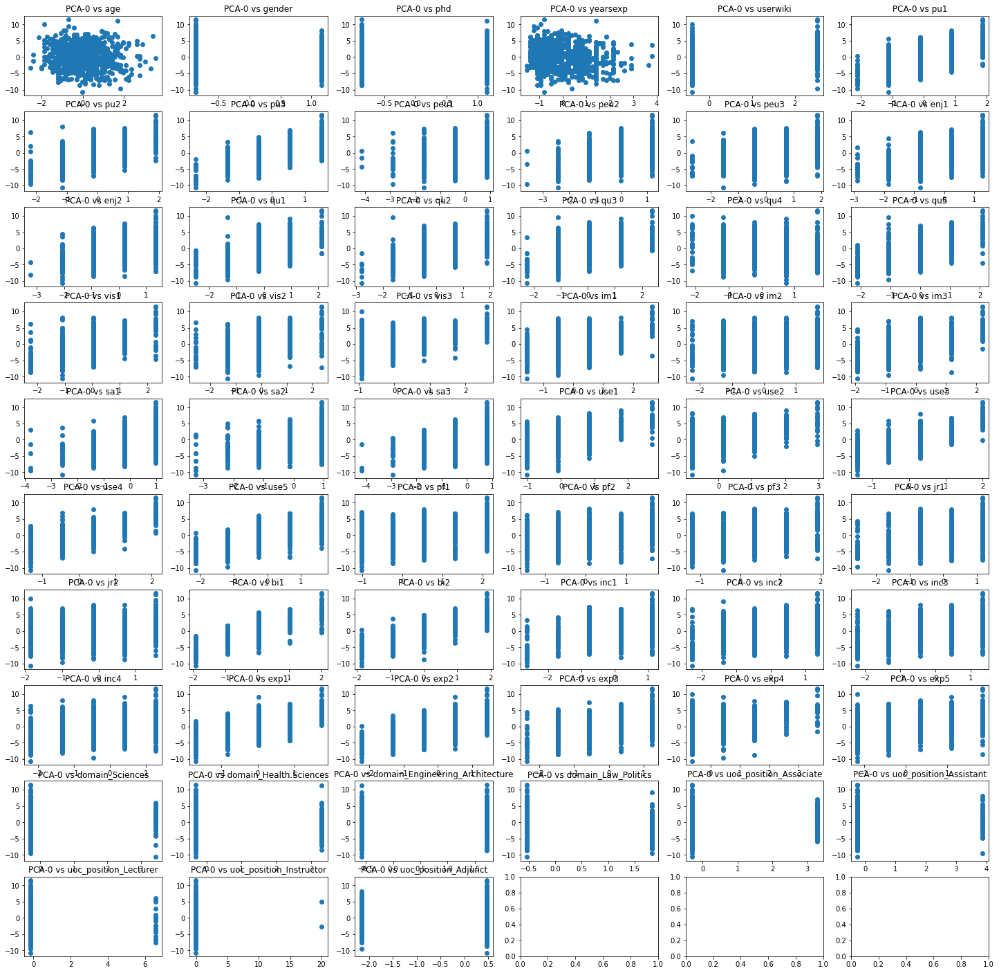

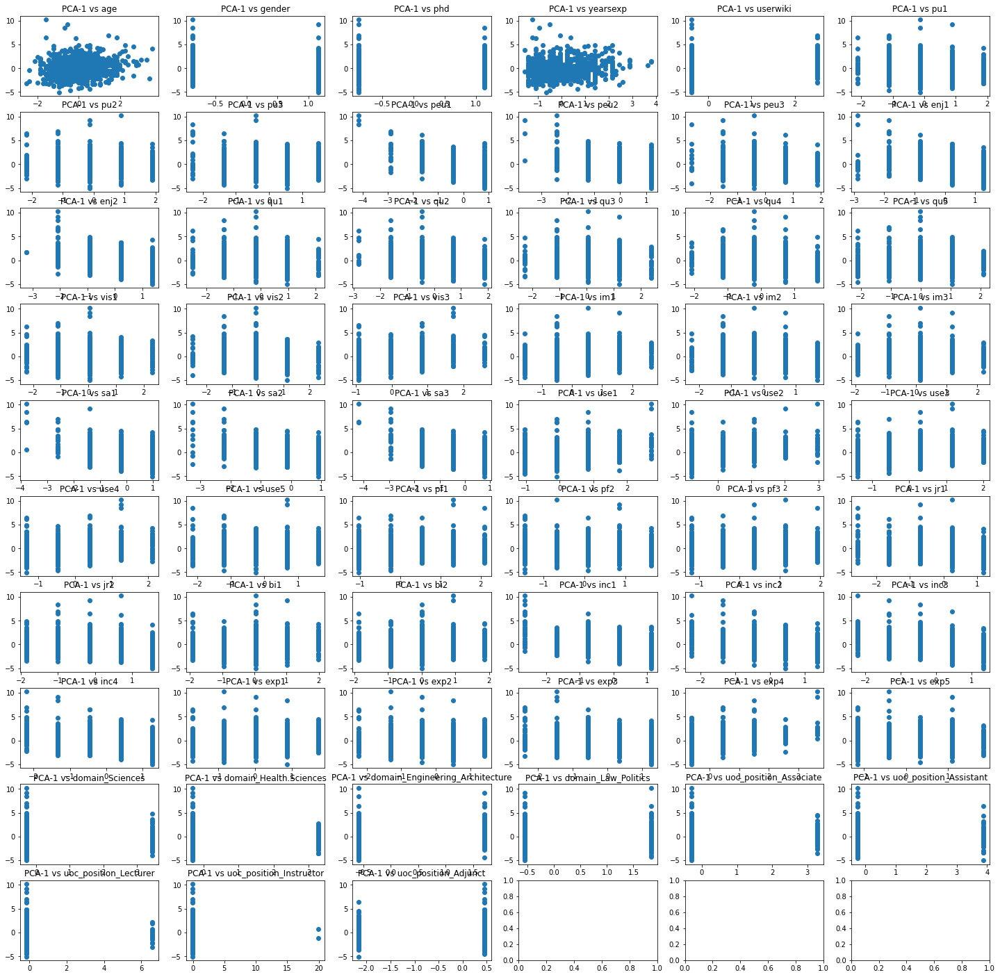

In [5]:
pca = PCA(n_components=2)
cats = pca.fit_transform(wiki)
fig, axs = plt.subplots(10, 6, figsize=(25, 25))
for ax, col in zip(axs.flat, wiki.columns):
    ax.scatter(wiki[col], cats[:, 0])
    ax.set_title(f'PCA-0 vs {col}')
plt.show()
fig, axs = plt.subplots(10, 6, figsize=(25, 25))
for ax, col in zip(axs.flat, wiki.columns):
    ax.scatter(wiki[col], cats[:, 1])
    ax.set_title(f'PCA-1 vs {col}')
plt.show()

We see that the first component embodies a lot of the things that we would consider to be "response variables". These are things like percieved usefulness and percieved ease of use. The second component is related to a number of things that we would consider to be "input variables" like incentives and experience.

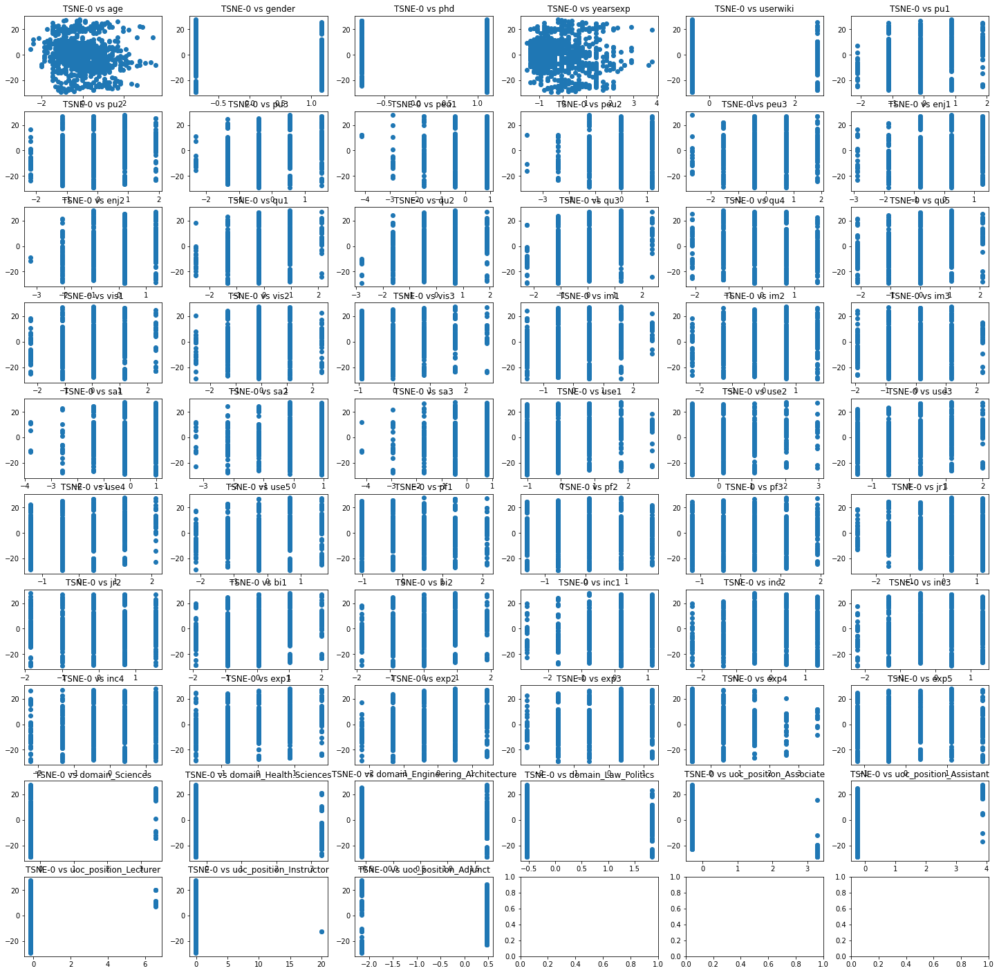

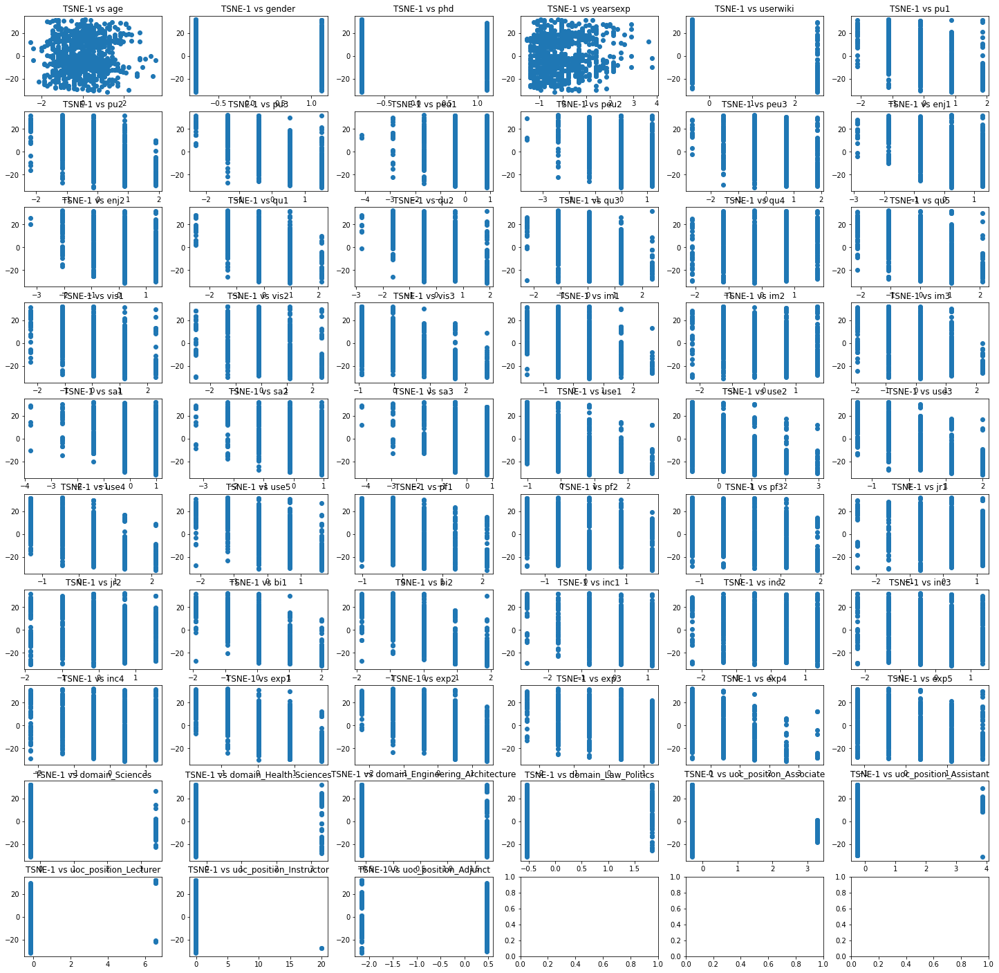

In [6]:
tsne = TSNE(n_components=2)
tcats = tsne.fit_transform(wiki)
fig, axs = plt.subplots(10, 6, figsize=(25, 25))
for ax, col in zip(axs.flat, wiki.columns):
    ax.scatter(wiki[col], tcats[:, 0])
    ax.set_title(f'TSNE-0 vs {col}')
plt.show()
fig, axs = plt.subplots(10, 6, figsize=(25, 25))
for ax, col in zip(axs.flat, wiki.columns):
    ax.scatter(wiki[col], tcats[:, 1])
    ax.set_title(f'TSNE-1 vs {col}')
plt.show()

The things that t-SNE latches on to are not as evident from the plots, however it constructs a manifold rather than identifying components, so perhaps that is just hard to see given this visualization.